In [14]:
import geopandas as gpd
from pyproj import CRS
import requests
import geojson
import folium

In [64]:
data = gpd.read_file("data/nyc_census_blocks.shp")

In [65]:
data.head()

,BLKID,POPN_TOTAL,POPN_WHITE,POPN_BLACK,POPN_NATIV,POPN_ASIAN,POPN_OTHER,BORONAME,geometry
0,360850009001000,97,51,32,1,5,8,Staten Island,"POLYGON ((577856.547 4499583.235, 577862.635 4..."
1,360850020011000,66,52,2,0,7,5,Staten Island,"POLYGON ((578620.717 4495974.818, 578535.358 4..."
2,360850040001000,62,14,18,2,25,3,Staten Island,"POLYGON ((577227.224 4495995.067, 577155.625 4..."
3,360850074001000,137,92,12,0,13,20,Staten Island,"POLYGON ((579037.033 4494421.770, 579000.015 4..."
4,360850096011000,289,230,0,0,32,27,Staten Island,"POLYGON ((577652.483 4494975.052, 577681.914 4..."


<AxesSubplot:>

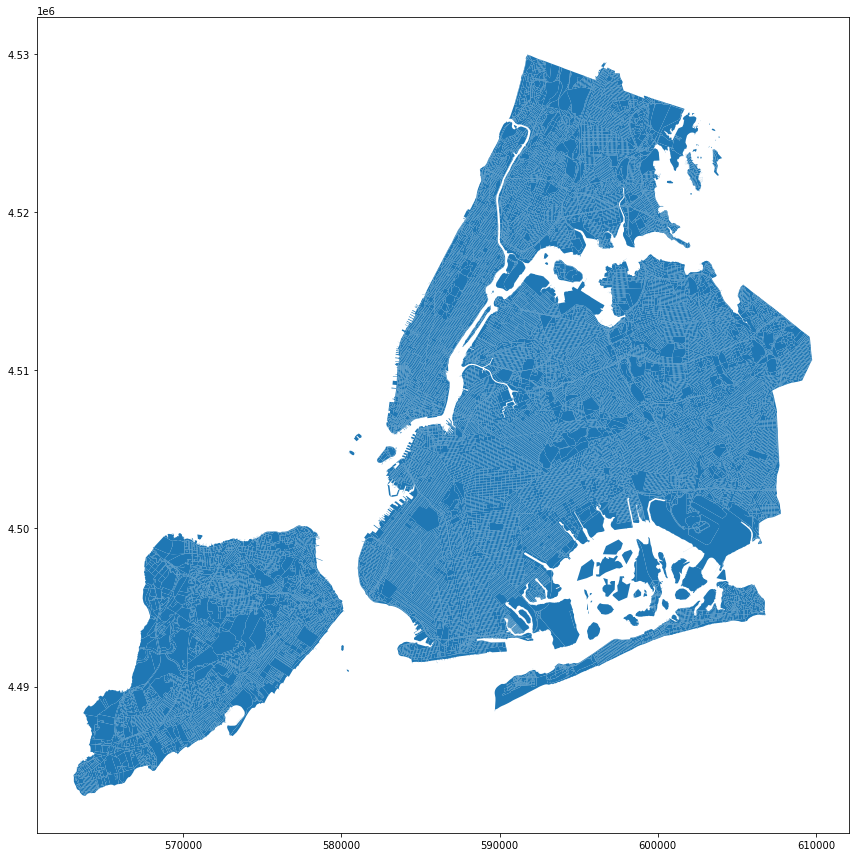

In [66]:
data.plot(figsize=(15,15))

In [67]:
import numpy as np
# Create a Geo-id which is needed by the Folium (it needs to have a unique identifier for each row)
data['geoid'] = data.index.astype(str)
data['white_black_ratio'] = data["POPN_WHITE"] / data["POPN_BLACK"]
data.replace([np.inf, -np.inf], np.nan, inplace=True)
data['white_black_ratio'] = data['white_black_ratio'].fillna(0)
data['white_black_ratio'] = data['white_black_ratio']/100

In [68]:
# Re-project to WGS84
data = data.to_crs(epsg=4326)

In [69]:
data = data[data["BORONAME"].isin(["Manhattan", "The Bronx"])]
data

,BLKID,POPN_TOTAL,POPN_WHITE,POPN_BLACK,POPN_NATIV,POPN_ASIAN,POPN_OTHER,BORONAME,geometry,geoid,white_black_ratio
1017,360610005000003,0,0,0,0,0,0,Manhattan,"MULTIPOLYGON (((-74.02021 40.68483, -74.02016 ...",1017,0.000000
1018,360610016001000,0,0,0,0,0,0,Manhattan,"POLYGON ((-73.99309 40.71792, -73.99370 40.716...",1018,0.000000
1019,360610022011000,463,90,38,4,97,234,Manhattan,"POLYGON ((-73.98131 40.72071, -73.98135 40.720...",1019,0.023684
1020,360610026021000,423,144,53,0,150,76,Manhattan,"POLYGON ((-73.97559 40.72428, -73.97593 40.723...",1020,0.027170
1021,360610030011000,623,399,20,3,149,52,Manhattan,"POLYGON ((-73.98629 40.72224, -73.98634 40.722...",1021,0.199500
...,...,...,...,...,...,...,...,...,...,...,...
38789,360050295001004,328,267,14,2,8,37,The Bronx,"POLYGON ((-73.90778 40.88637, -73.90813 40.885...",38789,0.190714
38790,360050295002002,0,0,0,0,0,0,The Bronx,"POLYGON ((-73.90626 40.88757, -73.90663 40.886...",38790,0.000000
38791,360050419004001,0,0,0,0,0,0,The Bronx,"POLYGON ((-73.88289 40.87883, -73.88185 40.877...",38791,0.000000
38792,360050255002001,480,96,96,20,12,256,The Bronx,"POLYGON ((-73.90861 40.86004, -73.91021 40.858...",38792,0.010000


In [70]:
# Create a Map instance
m = folium.Map(location=[40.64343,-74.07921], zoom_start=11, control_scale=True)

# Plot a choropleth map
# Notice: 'geoid' column that we created earlier needs to be assigned always as the first column
folium.Choropleth(
    geo_data=data,
    name='Population in 2020',
    data=data,
    columns=['geoid', 'POPN_TOTAL'],
    key_on='feature.id',
    fill_color='YlOrRd',
    fill_opacity=0.7,
    line_opacity=0.2,
    line_color='white', 
    line_weight=0,
    highlight=False, 
    smooth_factor=1.0,
    #threshold_scale=[100, 250, 500, 1000, 2000],
    legend_name= 'Population in New York').add_to(m)

folium.Choropleth(
    geo_data=data,
    name='Population ratio',
    data=data,
    columns=['geoid', 'white_black_ratio'],
    key_on='feature.id',
    fill_color='RdPu',
    fill_opacity=0.7,
    line_opacity=0.2,
    line_color='white', 
    line_weight=0,
    highlight=False, 
    smooth_factor=1.0,
    #threshold_scale=[100, 250, 500, 1000, 2000],
    legend_name= 'Population ratio in New York').add_to(m)

# Convert points to GeoJson
folium.features.GeoJson(data,  
                        name='Labels',
                        style_function=lambda x: {'color':'transparent','fillColor':'transparent','weight':0},
                        tooltip=folium.features.GeoJsonTooltip(fields=['POPN_TOTAL', 'POPN_WHITE', 'POPN_BLACK', 'POPN_ASIAN'],
                                                                aliases = ['Population','Population White', 'Population Black', 'Population Asian'],
                                                                labels=True,
                                                                sticky=False
                                                                            )
                       ).add_to(m)


#Show map
folium.LayerControl().add_to(m)

m